Visualization:

In [1]:
# Import the Pandas library with the alias 'pd'
import pandas as pd

# Read the data from the CSV file into a Pandas DataFrame named 'all_homes_df'
homes_df = pd.read_csv("../Resources/all_homes_with_addresses.csv")

# Display the DataFrame to view the loaded data
homes_df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity_<1H OCEAN,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN,Predicted_Values_RF,address
0,-122.23,37.88,41,880,129.0,322,126,8.3252,452600,0,0,0,1,0,454931.13,"Ecological Study Area, Segre Road, Berkeley, C..."
1,-122.22,37.86,21,7099,1106.0,2401,1138,8.3014,358500,0,0,0,1,0,379692.04,"Grizzly Peak Open Space, Skyline Trail, Contra..."
2,-122.24,37.85,52,1467,190.0,496,177,7.2574,352100,0,0,0,1,0,375770.01,"Grove Shafter Freeway, Oakland, CA 94618, Unit..."
3,-122.25,37.85,52,1274,235.0,558,219,5.6431,341300,0,0,0,1,0,336643.02,"6365 Florio Street, Oakland, CA 94168, United ..."
4,-122.25,37.85,52,1627,280.0,565,259,3.8462,342200,0,0,0,1,0,293841.00,"6365 Florio Street, Oakland, CA 94168, United ..."


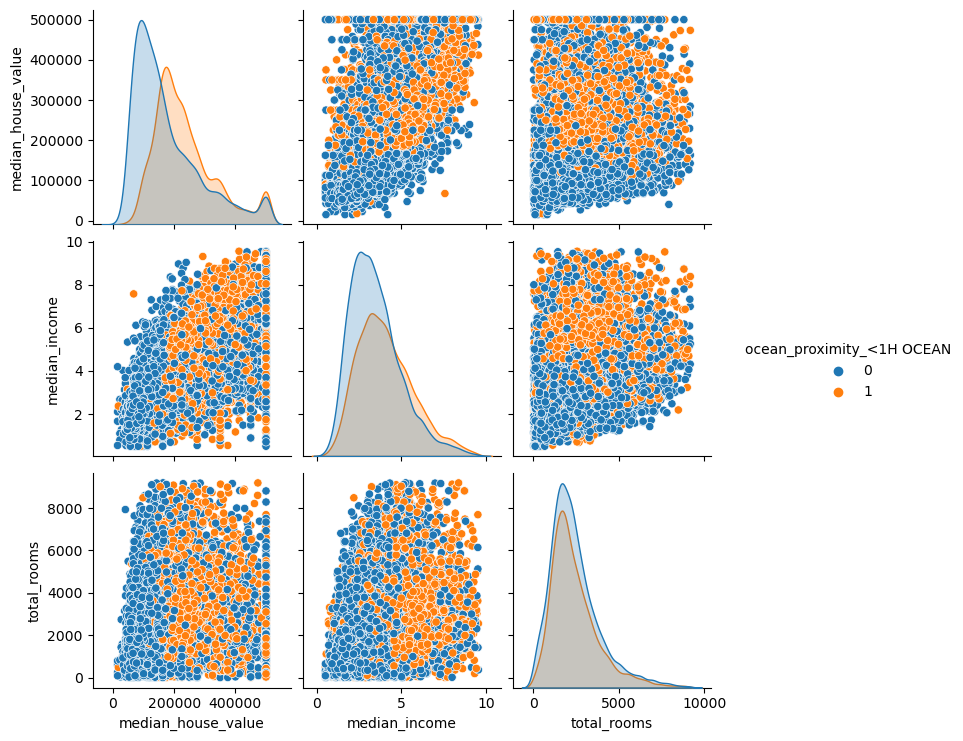

In [2]:
#Pair Plot:
import seaborn as sns
import matplotlib.pyplot as plt

# from DataFrame named 'all_homes_df_encoded'
sns.pairplot(homes_df, hue='ocean_proximity_<1H OCEAN', vars=['median_house_value', 'median_income', 'total_rooms'])
plt.show()

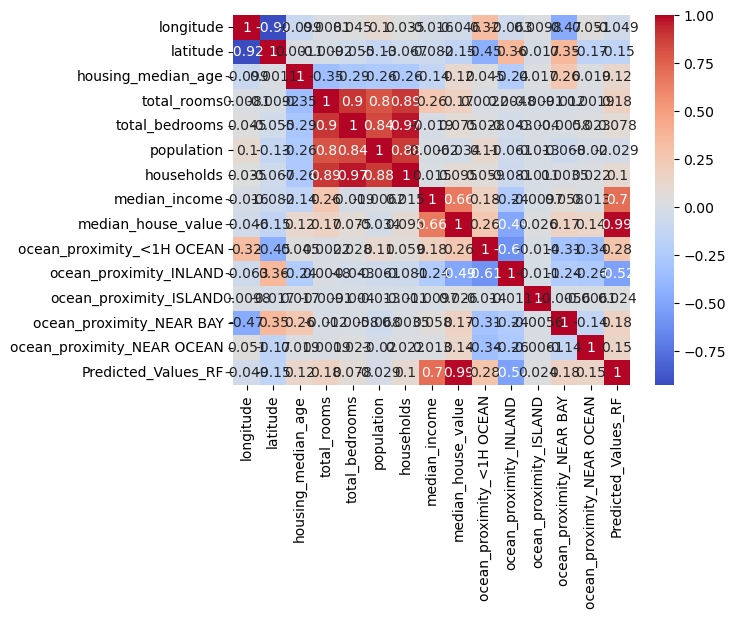

In [3]:
#Correlation Heatmap:
import seaborn as sns
import matplotlib.pyplot as plt

# from a DataFrame named 'all_homes_df_encoded'
correlation_matrix = homes_df.corr(numeric_only=True)
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

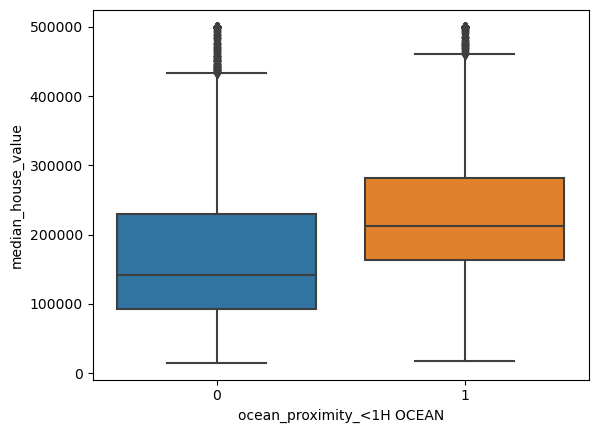

In [4]:
#Box Plots:
sns.boxplot(x='ocean_proximity_<1H OCEAN', y='median_house_value', data=homes_df)
plt.show()

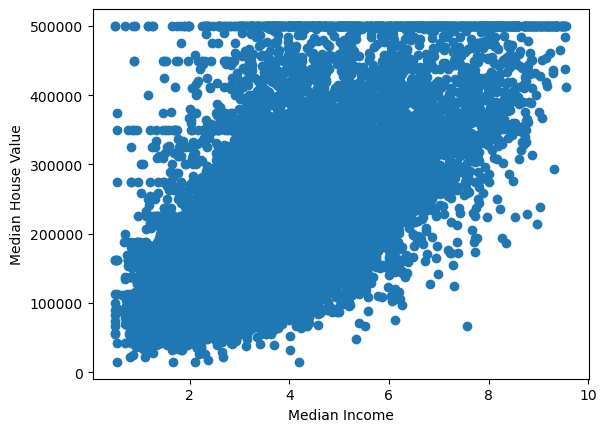

In [5]:
#Scatter Plots:
plt.scatter(homes_df['median_income'], homes_df['median_house_value'])
plt.xlabel('Median Income')
plt.ylabel('Median House Value')
plt.show()

In [9]:
import folium

# Assuming the DataFrame is named 'all_homes_df_encoded'
map_center = [homes_df['latitude'].mean(), homes_df['longitude'].mean()]

# Create a folium map centered at the mean coordinates
my_map = folium.Map(location=map_center, zoom_start=10)

# Add markers for each data point
for index, row in homes_df.iterrows():
    folium.Marker([row['latitude'], row['longitude']],
                  popup=f"Median House Value: ${row['median_house_value']:,}",
                  icon=folium.Icon(color='blue')).add_to(my_map)

# Save the map to an HTML file or display it in a Jupyter Notebook
my_map.save('geospatial_visualization.html')

In [10]:
import folium
from folium import plugins

# from a DataFrame named 'homes_df' with 'latitude' and 'longitude' columns
map_center = [homes_df['latitude'].mean(), homes_df['longitude'].mean()]

# Create a folium map centered at the mean coordinates
my_map = folium.Map(location=map_center, zoom_start=10)

# Add markers for each data point
for index, row in homes_df.iterrows():
    folium.Marker([row['latitude'], row['longitude']],
                  popup=f"Median House Value: ${row['median_house_value']:,}",
                  icon=folium.Icon(color='blue')).add_to(my_map)

# Use a folium plugin for better integration in Jupyter Notebooks
plugins.FastMarkerCluster(homes_df[['latitude', 'longitude']].values).add_to(my_map)

# Display the map directly in the Jupyter Notebook
my_map

Analysis:


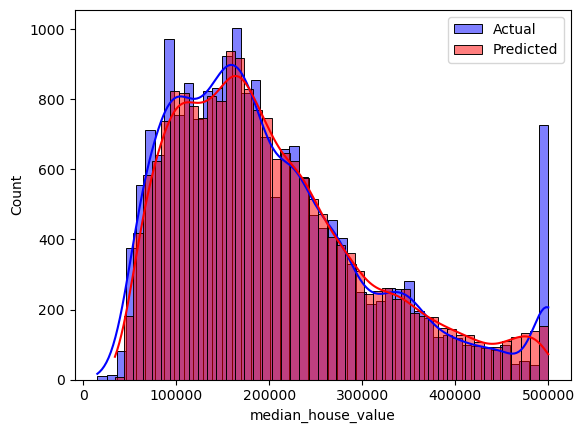

In [11]:
# Prediction Analysis:
sns.histplot(homes_df['median_house_value'], label='Actual', color='blue', kde=True)
sns.histplot(homes_df['Predicted_Values_RF'], label='Predicted', color='red', kde=True)
plt.legend()
plt.show()

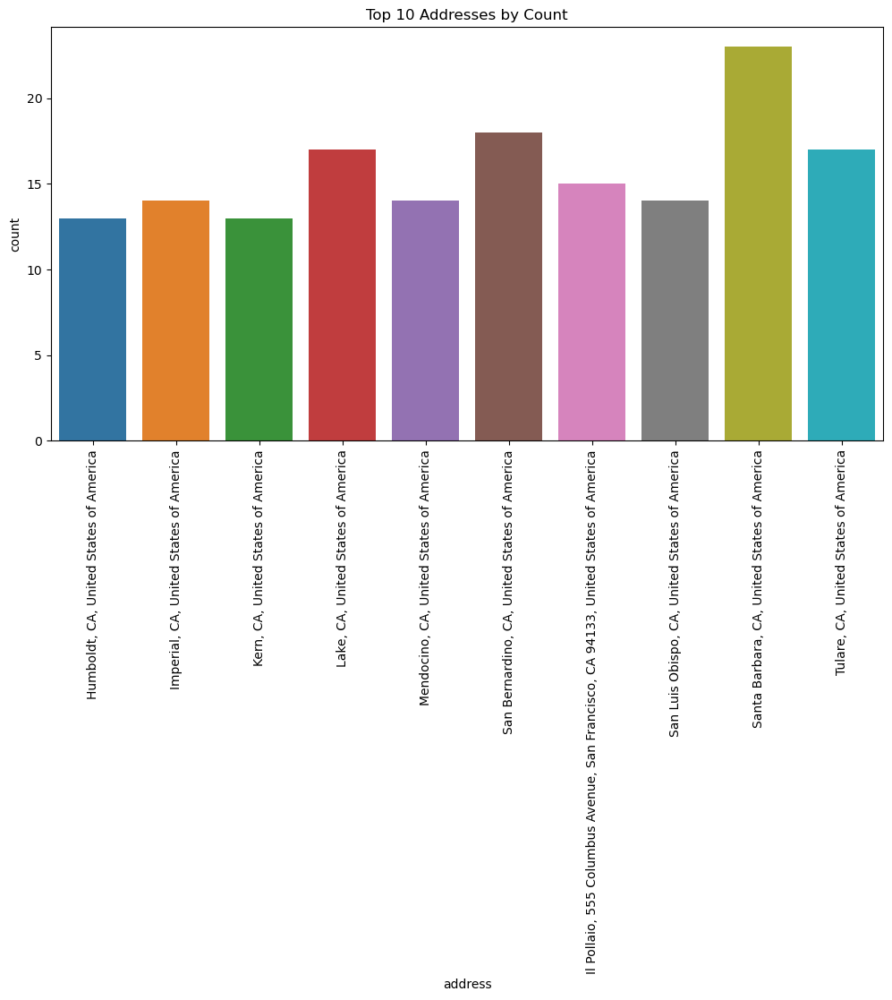

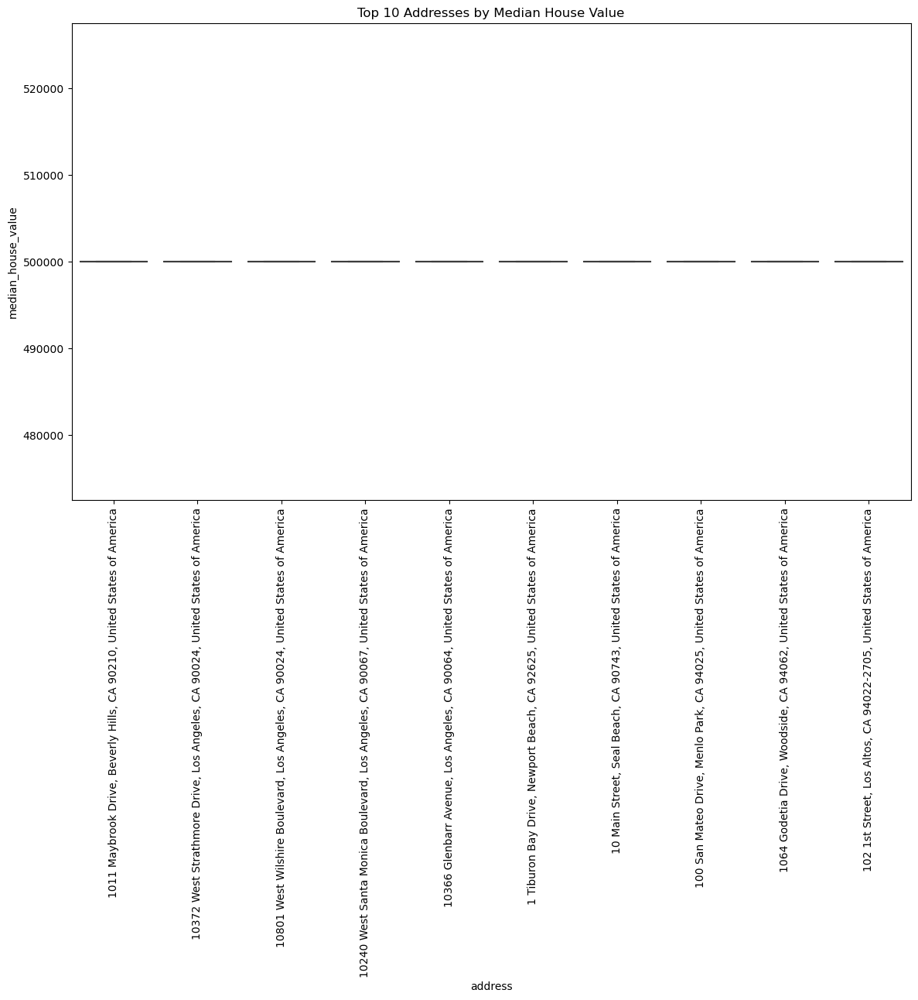

In [13]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'homes_df' with features and target
# Replace 'address' with the actual name of your address column
address_column = 'address'
target_variable_name = 'median_house_value'

# Top-N Addresses by Count
top_n_addresses_count = 10  # Set the desired number of top addresses
top_addresses_count = homes_df[address_column].value_counts().nlargest(top_n_addresses_count).index
filtered_df_count = homes_df[homes_df[address_column].isin(top_addresses_count)]

# Visualize the distribution of top addresses by count
plt.figure(figsize=(12, 6))
sns.countplot(data=filtered_df_count, x=address_column)
plt.title(f'Top {top_n_addresses_count} Addresses by Count')
plt.xticks(rotation=90)
plt.show()

# Top-N Addresses by Median House Value
top_n_addresses_value = 10  # Set the desired number of top addresses
median_house_value_by_address = homes_df.groupby(address_column)[target_variable_name].median()
top_addresses_value = median_house_value_by_address.nlargest(top_n_addresses_value).index
filtered_df_value = homes_df[homes_df[address_column].isin(top_addresses_value)]

# Visualize the distribution of top addresses by median house value
plt.figure(figsize=(14, 8))
sns.boxplot(data=filtered_df_value, x=address_column, y=target_variable_name)
plt.title(f'Top {top_n_addresses_value} Addresses by Median House Value')
plt.xticks(rotation=90)
plt.show()

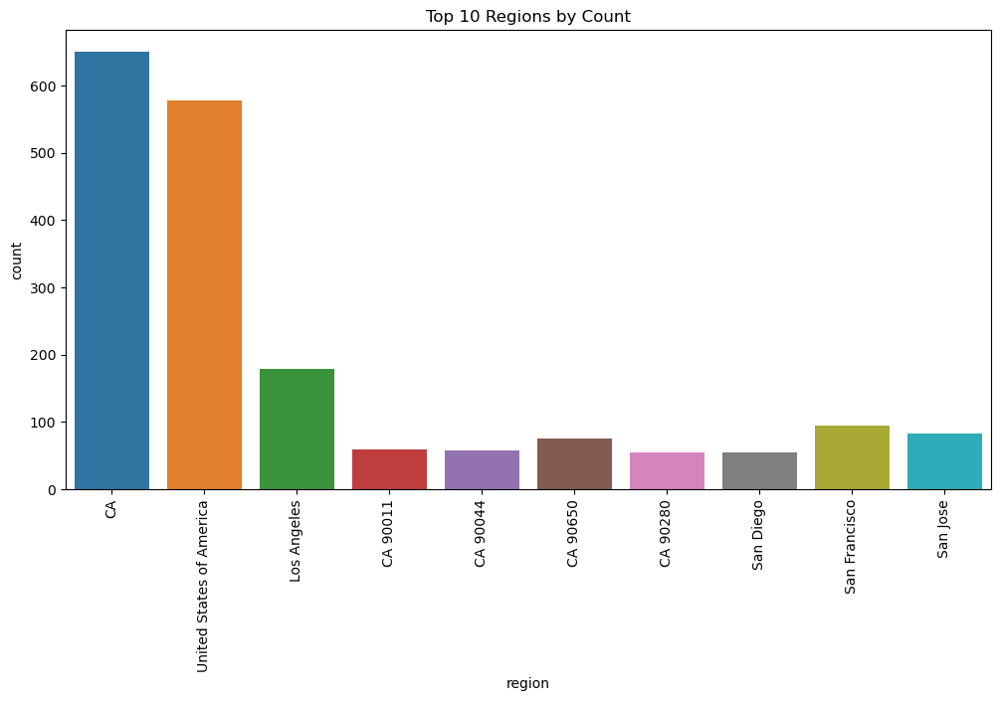

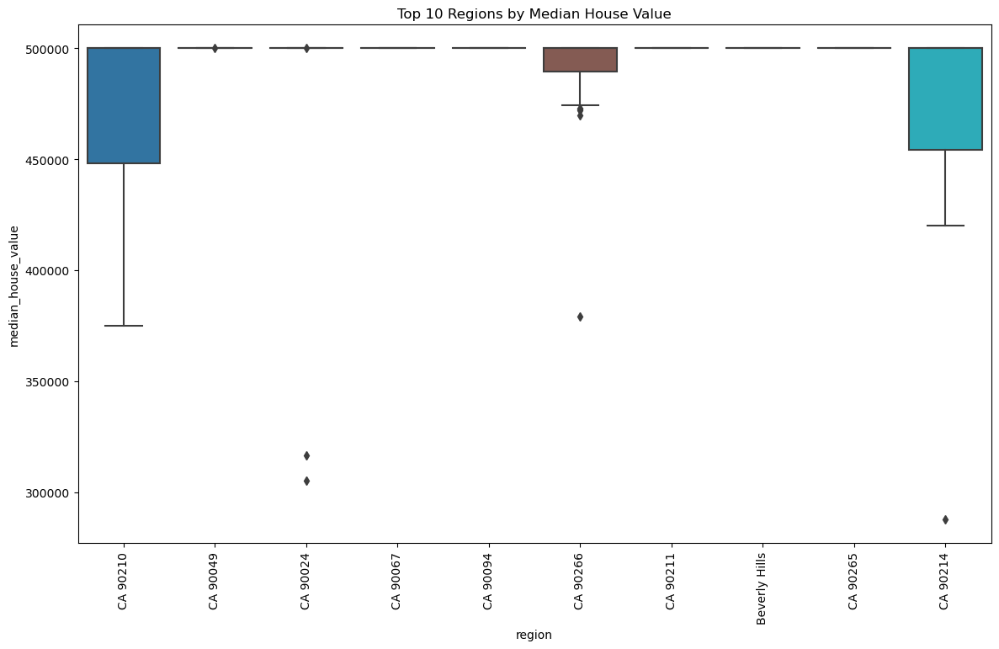

In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'homes_df' with features and target
# Replace 'address' with the actual name of your address column
address_column = 'address'
target_variable_name = 'median_house_value'

# Extracting region information from the 'address' column
homes_df['region'] = homes_df[address_column].apply(lambda x: x.split(',')[2].strip())

# Top-N Regions by Count
top_n_regions_count = 10  # Set the desired number of top regions
top_regions_count = homes_df['region'].value_counts().nlargest(top_n_regions_count).index
filtered_df_count = homes_df[homes_df['region'].isin(top_regions_count)]

# Visualize the distribution of top regions by count
plt.figure(figsize=(12, 6))
sns.countplot(data=filtered_df_count, x='region')
plt.title(f'Top {top_n_regions_count} Regions by Count')
plt.xticks(rotation=90)
plt.show()

# Top-N Regions by Median House Value
top_n_regions_value = 10  # Set the desired number of top regions
median_house_value_by_region = homes_df.groupby('region')[target_variable_name].median()
top_regions_value = median_house_value_by_region.nlargest(top_n_regions_value).index
filtered_df_value = homes_df[homes_df['region'].isin(top_regions_value)]

# Visualize the distribution of top regions by median house value
plt.figure(figsize=(14, 8))
sns.boxplot(data=filtered_df_value, x='region', y=target_variable_name)
plt.title(f'Top {top_n_regions_value} Regions by Median House Value')
plt.xticks(rotation=90)
plt.show()

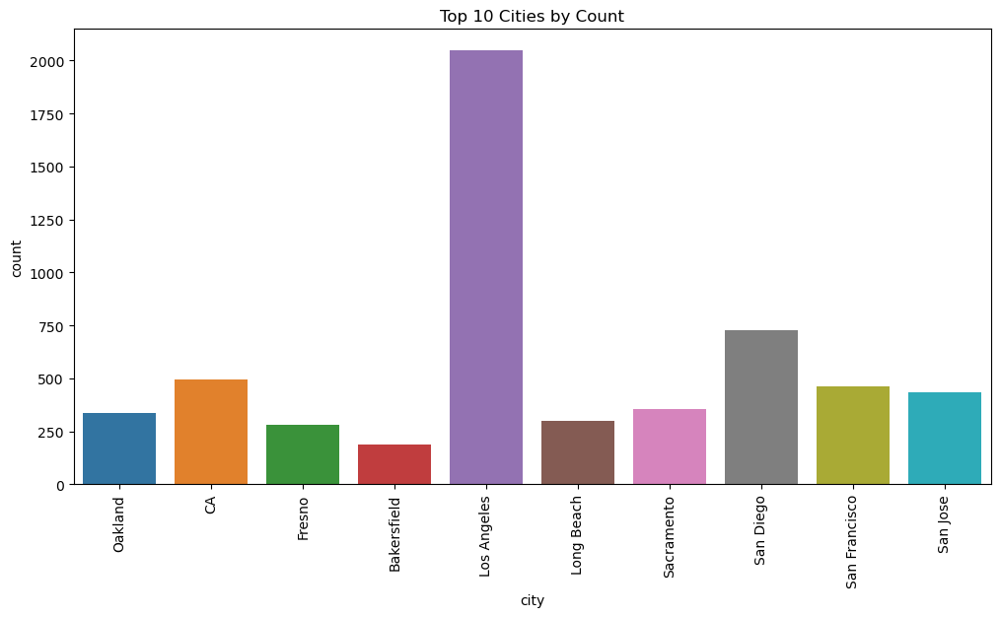

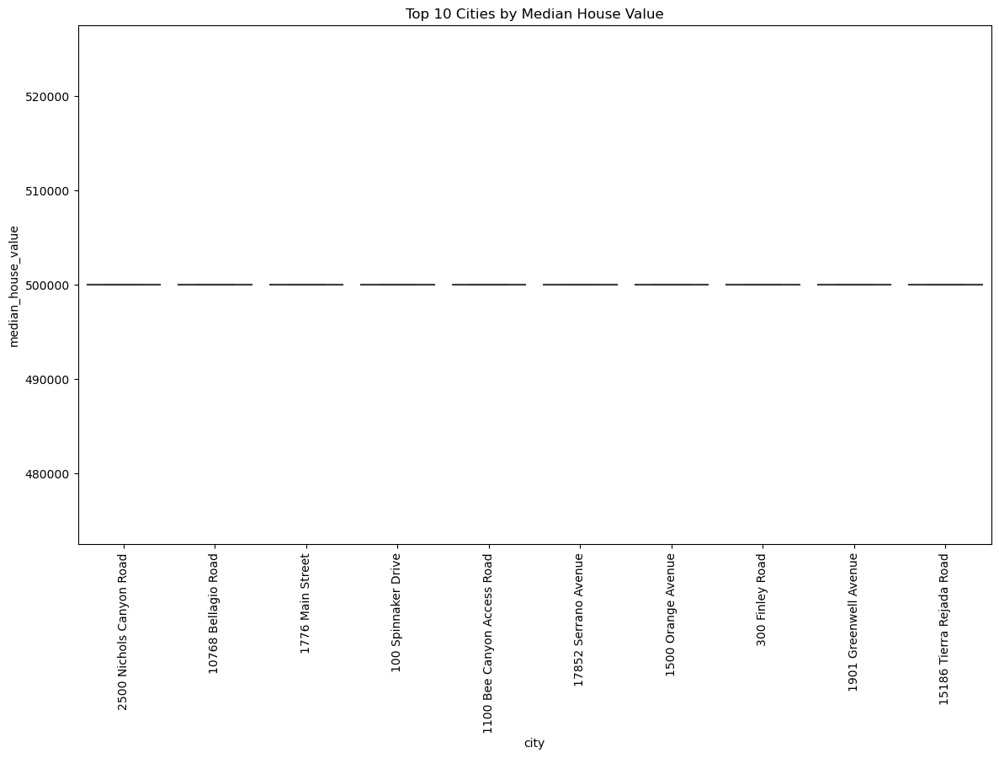

In [15]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'homes_df' with features and target
# Replace 'address' and 'median_house_value' with the actual names of your columns
address_column = 'address'
target_variable_name = 'median_house_value'

# Extracting city information from the 'address' column
homes_df['city'] = homes_df[address_column].apply(lambda x: x.split(',')[1].strip())

# Top-N Cities by Count
top_n_cities_count = 10  # Set the desired number of top cities
top_cities_count = homes_df['city'].value_counts().nlargest(top_n_cities_count).index
filtered_df_count = homes_df[homes_df['city'].isin(top_cities_count)]

# Visualize the distribution of top cities by count
plt.figure(figsize=(12, 6))
sns.countplot(data=filtered_df_count, x='city')
plt.title(f'Top {top_n_cities_count} Cities by Count')
plt.xticks(rotation=90)
plt.show()

# Top-N Cities by Median House Value
top_n_cities_value = 10  # Set the desired number of top cities
median_house_value_by_city = homes_df.groupby('city')[target_variable_name].median()
top_cities_value = median_house_value_by_city.nlargest(top_n_cities_value).index
filtered_df_value = homes_df[homes_df['city'].isin(top_cities_value)]

# Visualize the distribution of top cities by median house value
plt.figure(figsize=(14, 8))
sns.boxplot(data=filtered_df_value, x='city', y=target_variable_name)
plt.title(f'Top {top_n_cities_value} Cities by Median House Value')
plt.xticks(rotation=90)
plt.show()

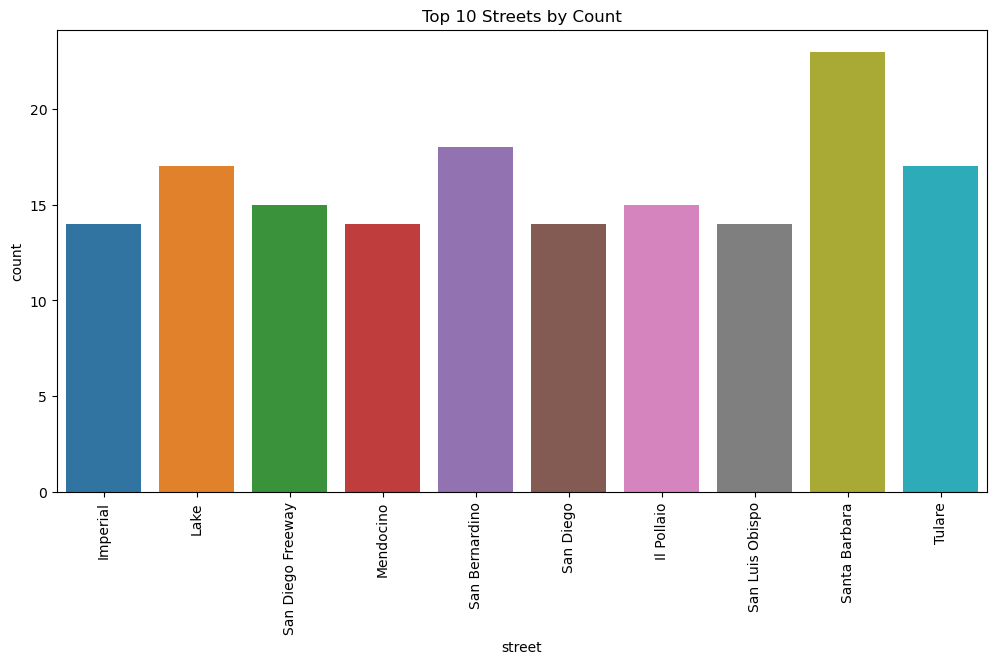

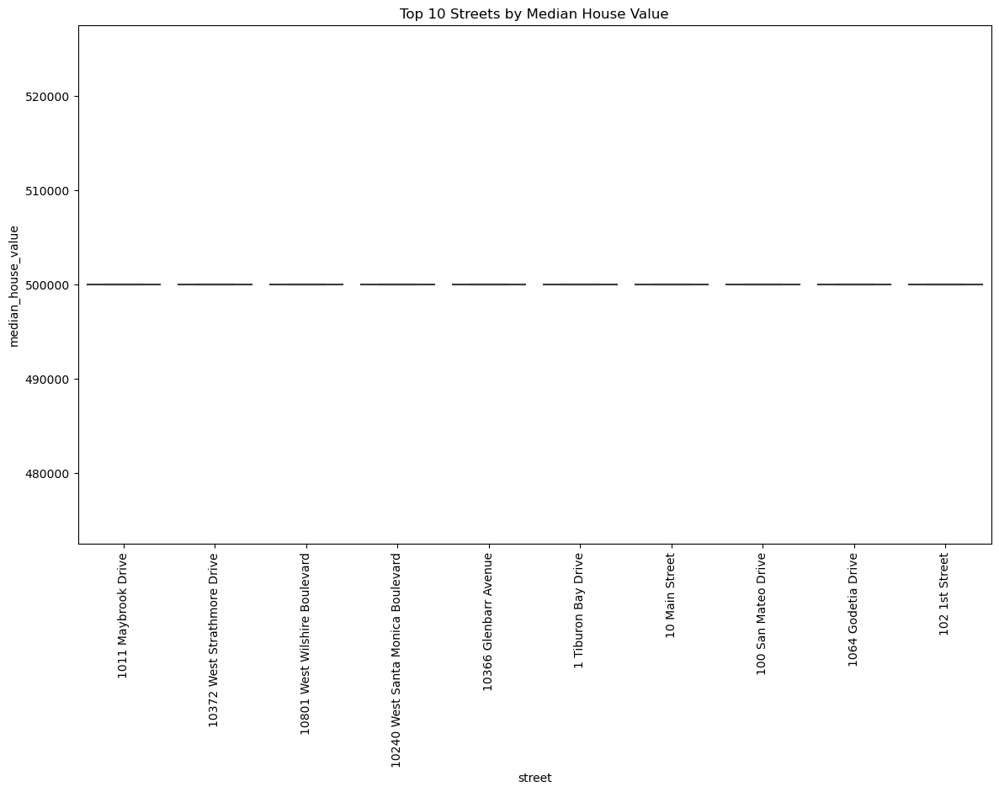

In [16]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'homes_df' with features and target
# Replace 'address' and 'median_house_value' with the actual names of your columns
address_column = 'address'
target_variable_name = 'median_house_value'

# Extracting street information from the 'address' column
homes_df['street'] = homes_df[address_column].apply(lambda x: x.split(',')[0].strip())

# Top-N Streets by Count
top_n_streets_count = 10  # Set the desired number of top streets
top_streets_count = homes_df['street'].value_counts().nlargest(top_n_streets_count).index
filtered_df_count = homes_df[homes_df['street'].isin(top_streets_count)]

# Visualize the distribution of top streets by count
plt.figure(figsize=(12, 6))
sns.countplot(data=filtered_df_count, x='street')
plt.title(f'Top {top_n_streets_count} Streets by Count')
plt.xticks(rotation=90)
plt.show()

# Top-N Streets by Median House Value
top_n_streets_value = 10  # Set the desired number of top streets
median_house_value_by_street = homes_df.groupby('street')[target_variable_name].median()
top_streets_value = median_house_value_by_street.nlargest(top_n_streets_value).index
filtered_df_value = homes_df[homes_df['street'].isin(top_streets_value)]

# Visualize the distribution of top streets by median house value
plt.figure(figsize=(14, 8))
sns.boxplot(data=filtered_df_value, x='street', y=target_variable_name)
plt.title(f'Top {top_n_streets_value} Streets by Median House Value')
plt.xticks(rotation=90)
plt.show()

In [18]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import pandas as pd
import plotly.express as px

# Assuming you have a DataFrame named 'homes_df'
# Replace with your actual data loading logic

app = dash.Dash(__name__)

# Define layout
app.layout = html.Div([
    html.H1("Interactive Dashboard"),
    
    dcc.Dropdown(
        id='city-dropdown',
        options=[{'label': city, 'value': city} for city in homes_df['address'].unique()],
        value='Default City',
        multi=False
    ),
    
    dcc.Dropdown(
        id='x-axis-dropdown',
        options=[{'label': feature, 'value': feature} for feature in homes_df.columns],
        value='total_rooms',
        multi=False
    ),
    
    dcc.Dropdown(
        id='color-dropdown',
        options=[{'label': feature, 'value': feature} for feature in ['median_house_value', 'Predicted_Values_RF']],
        value='median_house_value',
        multi=False
    ),
    
    dcc.Graph(id='scatter-plot'),
])

# Define callback
@app.callback(
    Output('scatter-plot', 'figure'),
    [Input('city-dropdown', 'value'),
     Input('x-axis-dropdown', 'value'),
     Input('color-dropdown', 'value')]
)
def update_scatter_plot(selected_city, x_axis_feature, color_feature):
    filtered_df = homes_df[homes_df['address'] == selected_city]
    fig = px.scatter(filtered_df, x=x_axis_feature, y='median_house_value', color=color_feature,
                     title=f"Scatter Plot for {x_axis_feature} vs {color_feature}")
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)